In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [2]:
trips_complete=pd.read_csv(r'C:\Users\Chris\NSSFiles\Python\Notebooks\Trips_Complete_Final_fantasy.csv')

In [3]:
bus_stops=pd.read_csv(r'C:\Users\Chris\NSSFiles\Python\Projects\nashville_scooters-panthers\bus_stops_geo.csv')

In [4]:
zipcodes = gpd.read_file(r'C:\Users\Chris\NSSFiles\Python\Data\zipcodes.geojson')

In [5]:
bus_stops.drop_duplicates(subset=['Stop ID Number','Stop Abbreviation'],inplace=True)

In [6]:
bus_stops.shape

(33, 12)

In [7]:
zipcodes.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [8]:
trips_complete['geometry_start'] = trips_complete.apply(lambda x: Point((float(x.StartLong),
                                                float(x.StartLat))),
                               axis=1)

In [9]:
trips_complete['geometry_end'] = trips_complete.apply(lambda x: Point((float(x.EndLong),
                                                float(x.EndLat))),
                               axis=1)

In [10]:
bus_stops['geometry_bus'] = bus_stops.apply(lambda x: Point((float(x.Longitude),
                                                float(x.Latitude))),
                               axis=1)

In [11]:
trips_geo_start=gpd.GeoDataFrame(trips_complete,
                         crs=zipcodes.crs,
                          geometry = trips_complete['geometry_start'])

In [12]:
trips_geo_end=gpd.GeoDataFrame(trips_complete,
                         crs=zipcodes.crs,
                          geometry = trips_complete['geometry_end'])

In [13]:
bus_geo = gpd.GeoDataFrame(bus_stops, 
                           crs = zipcodes.crs, 
                           geometry = bus_stops['geometry_bus'])

<AxesSubplot:>

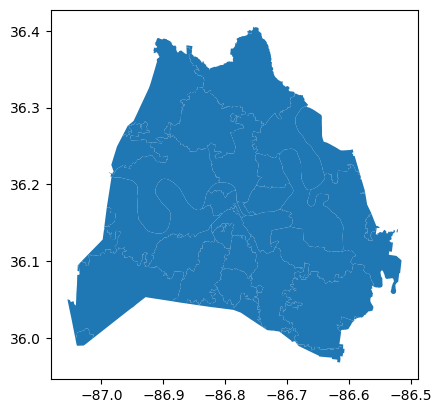

In [14]:
zipcodes.plot()

In [15]:
trips_complete.tail()

,Unnamed: 0,Bus Stop,Trip ID,Scooter ID,EndLat,EndLong,End To Bus,StartLat,StartLong,Start to Bus,geometry_start,geometry_end,geometry
20224,20224,4596,SPI566,Powered7955424,36.157795,-86.784700,40.595797,NaN,NaN,NaN,POINT (nan nan),POINT (-86.78469971778173 36.15779484553536),POINT (-86.78470 36.15779)
20225,20225,4596,SPI565,Powered6387861,36.157723,-86.784491,49.515303,NaN,NaN,NaN,POINT (nan nan),POINT (-86.78449127541154 36.15772345457312),POINT (-86.78449 36.15772)
20226,20226,4596,SPI597,Powered6387861,NaN,NaN,NaN,36.157770,-86.784313,104.703453,POINT (-86.78431316629869 36.15777037004788),POINT (nan nan),POINT (nan nan)
20227,20227,487,SPI622,Powered1572748,36.158349,-86.783141,119.046343,NaN,NaN,NaN,POINT (nan nan),POINT (-86.78314081401264 36.15834931380689),POINT (-86.78314 36.15835)
20228,20228,487,SPI568,Powered1756874,NaN,NaN,NaN,36.158255,-86.783156,121.298997,POINT (-86.78315623671446 36.15825514312476),POINT (nan nan),POINT (nan nan)


In [16]:
zipcodes.geometry.centroid

C:\Users\17046\AppData\Local\Temp\ipykernel_72\3801680343.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  zipcodes.geometry.centroid


0     POINT (-86.69477 36.25433)
1     POINT (-86.72635 36.21605)
2     POINT (-86.77467 36.10566)
3     POINT (-86.78551 36.04148)
4     POINT (-87.02866 36.00026)
5     POINT (-87.03712 36.08997)
6     POINT (-86.86263 36.38001)
7     POINT (-86.97531 36.06283)
8     POINT (-86.76433 36.33621)
9     POINT (-86.80157 36.13335)
10    POINT (-86.63653 35.98113)
11    POINT (-86.72226 36.00938)
12    POINT (-86.91816 36.15605)
13    POINT (-86.73098 36.18090)
14    POINT (-86.69470 36.00387)
15    POINT (-86.85733 36.37882)
16    POINT (-86.72570 36.00942)
17    POINT (-86.66093 36.10779)
18    POINT (-86.82996 36.27880)
19    POINT (-86.78726 36.28724)
20    POINT (-86.89487 36.32034)
21    POINT (-86.68513 35.99434)
22    POINT (-86.64118 36.25192)
23    POINT (-86.98674 36.15655)
24    POINT (-86.78317 36.16682)
25    POINT (-86.68331 35.99201)
26    POINT (-86.76289 36.39920)
27    POINT (-86.89039 36.20505)
28    POINT (-86.52221 36.13926)
29    POINT (-86.67866 35.98840)
30    POIN

In [17]:
center = zipcodes.geometry.centroid[9]
area_center = [center.y, center.x]

C:\Users\17046\AppData\Local\Temp\ipykernel_72\3436921403.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  center = zipcodes.geometry.centroid[9]


In [47]:
bus_marker=gpd.sjoin(bus_geo,zipcodes,op='within')
start_bus=gpd.sjoin(trips_geo_start,zipcodes,op='within')


ValueError: Can only compare identically-labeled DataFrame objects

In [48]:
end_bus=gpd.sjoin(trips_geo_end,zipcodes,op='within')

In [50]:
end_bus.head()

,Unnamed: 0,Bus Stop,Trip ID,Scooter ID,EndLat,EndLong,End To Bus,StartLat,StartLong,Start to Bus,geometry_start,geometry_end,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
0,0,4418,BRD5032,PoweredPXIRJ,36.1660,-86.7820,201.439629,NaN,NaN,NaN,POINT (nan nan),POINT (-86.782 36.166),POINT (-86.78200 36.16600),24,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
1,1,4429,BRD5032,PoweredPXIRJ,36.1660,-86.7820,103.089532,NaN,NaN,NaN,POINT (nan nan),POINT (-86.782 36.166),POINT (-86.78200 36.16600),24,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
2,2,4431,BRD5032,PoweredPXIRJ,36.1660,-86.7820,215.484646,NaN,NaN,NaN,POINT (nan nan),POINT (-86.782 36.166),POINT (-86.78200 36.16600),24,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
24,24,4418,BRD5567,Powered8FK2M,36.1664,-86.7823,130.628838,NaN,NaN,NaN,POINT (nan nan),POINT (-86.78230000000001 36.1664),POINT (-86.78230 36.16640),24,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328
25,25,4429,BRD5567,Powered8FK2M,36.1664,-86.7823,139.305524,NaN,NaN,NaN,POINT (nan nan),POINT (-86.78230000000001 36.1664),POINT (-86.78230 36.16640),24,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328


In [22]:
zip_map_start = folium.Map(location =  area_center, zoom_start = 12)
folium.GeoJson(zipcodes).add_to(zip_map_start)


marker_cluster = MarkerCluster().add_to(zip_map_start)


for row_index, row_values in bus_marker.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Stop Name'])
    icon=folium.Icon(color="red",icon="bus", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 
    marker.add_to(zip_map_start)
    
for row_index, row_values in start_bus.iterrows():
    loc = row_values['StartLat'],row_values['StartLong']
    pop = str(row_values['Trip ID']) + str(row_values['Scooter ID'])
    icon=folium.Icon(color="blue",icon="star", prefix='fa')
    iframe=folium.Popup(pop,max_width=150)
    marker = folium.Marker(
        location = loc, 
        popup = iframe, icon = icon) 
    marker.add_to(marker_cluster)

zip_map_start

In [51]:
zip_map_end = folium.Map(location =  area_center, zoom_start = 12)
folium.GeoJson(zipcodes).add_to(zip_map_end)


marker_cluster = MarkerCluster().add_to(zip_map_end)


for row_index, row_values in bus_marker.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Stop Name'])
    icon=folium.Icon(color="red",icon="bus", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 
    marker.add_to(zip_map_end)
    
for row_index, row_values in end_bus.iterrows():
    loc = row_values['EndLat'],row_values['EndLong']
    pop = str(row_values['Trip ID']) + str(row_values['Scooter ID'])
    icon=folium.Icon(color="blue",icon="star", prefix='fa')
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    marker.add_to(marker_cluster)
    

zip_map_end

In [35]:
trips_complete=trips_complete.dropna(subset=['EndLat'])

trips_complete=trips_complete.dropna(subset=['EndLong'])

trips_complete=trips_complete.dropna(subset=['Trip ID'])

trips_complete=trips_complete.dropna(subset=['Scooter ID'])

In [36]:
zip_map_end = folium.Map(location =  area_center, zoom_start = 12)
folium.GeoJson(zipcodes).add_to(zip_map_end)


marker_cluster = MarkerCluster().add_to(zip_map_end)


for row_index, row_values in bus_marker.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Stop Name'])
    icon=folium.Icon(color="red",icon="bus", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 
    marker.add_to(zip_map_end)
    
for row_index, row_values in start_bus.iterrows():
    loc = row_values['EndLat'],row_values['EndLong']
    pop = str(row_values['Trip ID']) + str(row_values['Scooter ID'])
    icon=folium.Icon(color="blue",icon="star", prefix='fa')
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    marker.add_to(marker_cluster)
    

zip_map_end

ValueError: Location values cannot contain NaNs.

In [28]:
zip_map_start.save(r'C:\Users\Chris\NSSFiles\Python\Maps\zip_map_start.html')

In [38]:
last_mile=pd.read_csv(r'C:\Users\Chris\NSSFiles\Python\Notebooks\lastMile.csv')

In [39]:
last_mile['geometry'] = trips_complete.apply(lambda x: Point((float(x.EndLong),
                                                float(x.EndLat))),
                               axis=1)

In [40]:
last_mile_geo=gpd.GeoDataFrame(last_mile,
                         crs=zipcodes.crs,
                          geometry = last_mile['geometry'])

In [41]:
end_bus=gpd.sjoin(last_mile_geo,zipcodes,op='within')

In [45]:
zip_map_end = folium.Map(location =  area_center, zoom_start = 12)
folium.GeoJson(zipcodes).add_to(zip_map_end)


marker_cluster = MarkerCluster().add_to(zip_map_end)


for row_index, row_values in bus_marker.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Stop Name'])
    icon=folium.Icon(color="red",icon="bus", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 
    marker.add_to(zip_map_end)
    
for row_index, row_values in end_bus.iterrows():
    loc = row_values['EndLat'],row_values['EndLong']
    pop = str(row_values['trip ID']) + str(row_values['scooter ID'])
    icon=folium.Icon(color="blue",icon="star", prefix='fa')
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    marker.add_to(marker_cluster)
    

zip_map_end

In [52]:
zip_map_end.save(r'C:\Users\Chris\NSSFiles\Python\Maps\zip_map_end.html')